# Задание 6
## Ситникова Руслана 411 группа КНиИТ

Сделать 2 фотографии и склеить их в панораму с помощью OpenCV (RANSAC алгоритмом) - поперебирать алгоритмы нахождения особых точек (SIFT, ORB, BRIEF) и посмотреть как они работают (скорость, качество склейки)

**Перед началом в colab нужно загрузить изображения part1.jpg, part2.jpg, original.jpg**

stitching поддерживает 3.7 - 3.10 версии python

In [69]:
!python --version

Python 3.8.10


In [70]:
!pip install stitching

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Необходимые библиотеки

In [71]:
from matplotlib import pyplot as plt
import cv2 as cv
import numpy as np
import stitching
import time
from stitching.feature_detector import FeatureDetector

Изображения

In [72]:
imgs_names = ["part1.jpg", "part2.jpg"]
imgs = []
for img_name in imgs_names:
    imgs.append(cv.imread(img_name))

Функция для вывода изображения

In [73]:
def show(img, figsize):
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.show()

#### SIFT алгоритм

Нахождение особых точек

In [74]:
finder = FeatureDetector('sift')
features = [finder.detect_features(img) for img in imgs]

Особые точки первого изображения

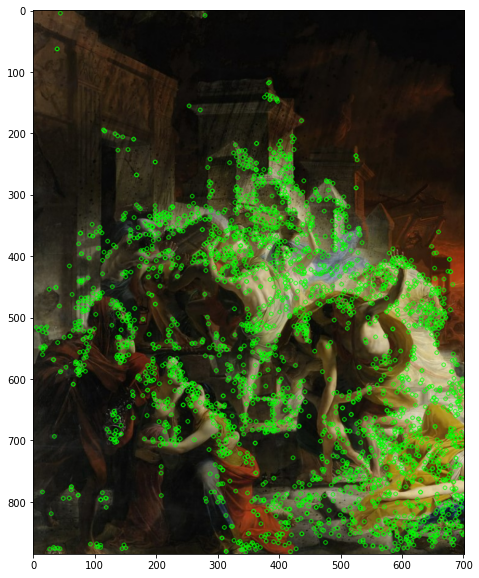

In [75]:
keypoints_sift = finder.draw_keypoints(imgs[0], features[0])
show(keypoints_sift, (15,10))

Особые точки второго изображения

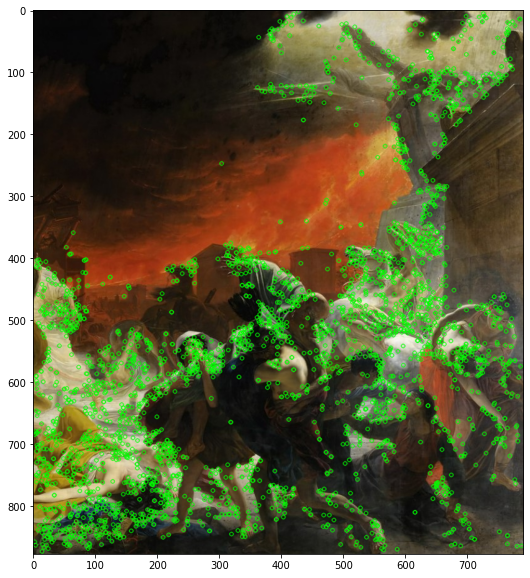

In [76]:
keypoints_sift = finder.draw_keypoints(imgs[1], features[1])
show(keypoints_sift, (15,10))

Execution time: 0.942147970199585


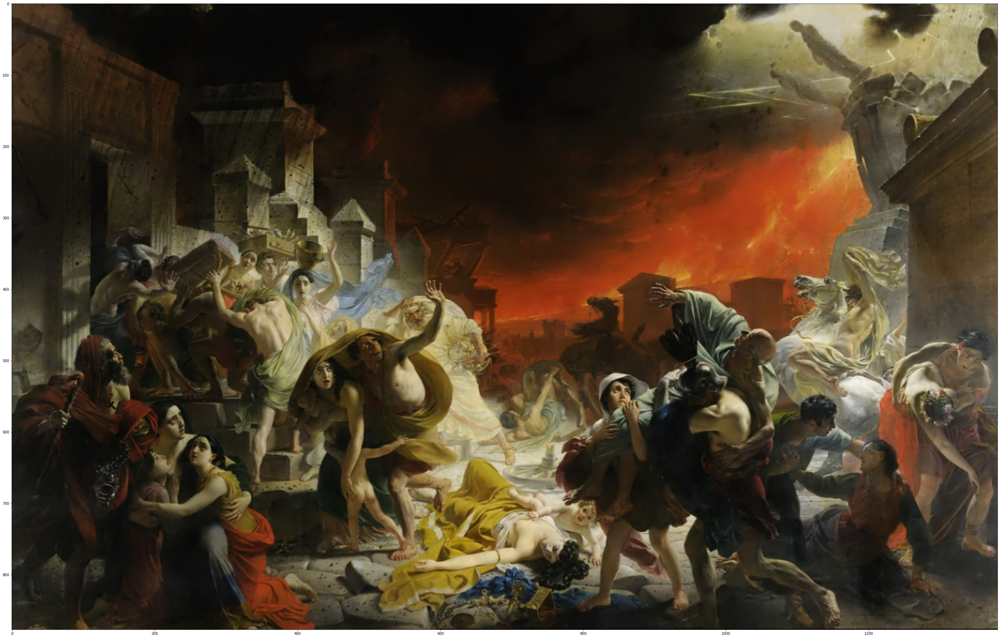

In [77]:
settings = {"detector": "sift", "confidence_threshold": 0.2}
stitcher = stitching.Stitcher(**settings)
start_time = time.time()
panorama_sift = stitcher.stitch(["part1.jpg", "part2.jpg"])
end_time = time.time()
print("Execution time:", end_time - start_time)
show(panorama_sift, (50,50))

#### ORB алгоритм

Нахождение особых точек

In [78]:
finder = FeatureDetector('orb')
features = [finder.detect_features(img) for img in imgs]

Особые точки первого изображения

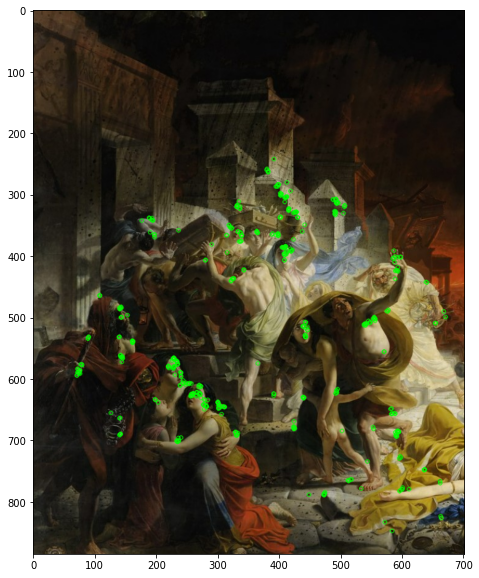

In [79]:
keypoints_orb = finder.draw_keypoints(imgs[0], features[0])
show(keypoints_orb, (15,10))

Особые точки второго изображения

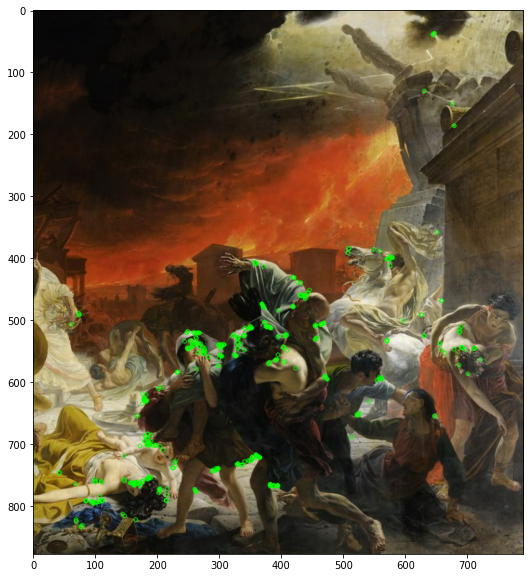

In [80]:
keypoints_orb = finder.draw_keypoints(imgs[1], features[1])
show(keypoints_orb, (15,10))

Execution time: 0.5917065143585205


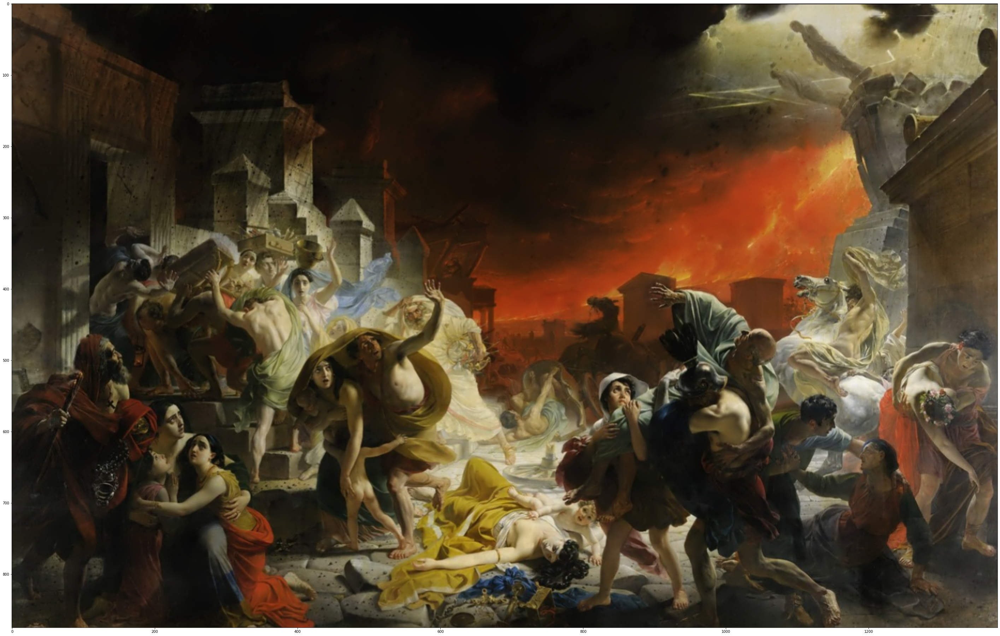

In [81]:
settings = {"detector": "orb", "confidence_threshold": 0.2}
stitcher = stitching.Stitcher(**settings)
start_time = time.time()
panorama_sift = stitcher.stitch(["part1.jpg", "part2.jpg"])
end_time = time.time()
print("Execution time:", end_time - start_time)
show(panorama_sift, (50,50))

#### BRIEF алгоритм

Первая часть была сделана на google colab, т.к. у меня на компьютере стоит python 3.11, который не поддерживается модулем stitching

Вторая часть сделана на локальном компьютере, потому что для BRIEF нужен модуль opencv-contrib-python, а не обычный opencv

In [80]:
import cv2
import numpy as np
import time
from matplotlib import pyplot as plt

Загрузка изображений

In [81]:
imgs_names = ["part1_brief.jpg", "part2_brief.jpg"]
imgs = []
for img_name in imgs_names:
    imgs.append(cv2.imread(img_name))

Вычисление особых точек

In [82]:
# перевод в серый
grays = [cv2.cvtColor(imgs[0], cv2.COLOR_BGR2GRAY), cv2.cvtColor(imgs[1], cv2.COLOR_BGR2GRAY)]

# вычисление особых точек
star = cv2.xfeatures2d.StarDetector_create()
keyPoints = [star.detect(grays[0], None), star.detect(grays[0], None)]

brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
keyPoints0, descriptors0 = brief.compute(imgs[0], keyPoints[0])
keyPoints1, descriptors1 = brief.compute(imgs[1], keyPoints[1])

# отрисовка
result0 = cv2.drawKeypoints(imgs[0], keyPoints[0], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
result1 = cv2.drawKeypoints(imgs[1], keyPoints[1], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

Особые точки для левого изображения

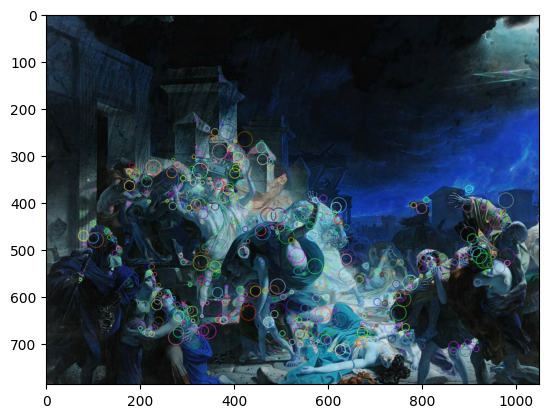

In [83]:
plt.imshow(result0)

Особые точки для правого изображения

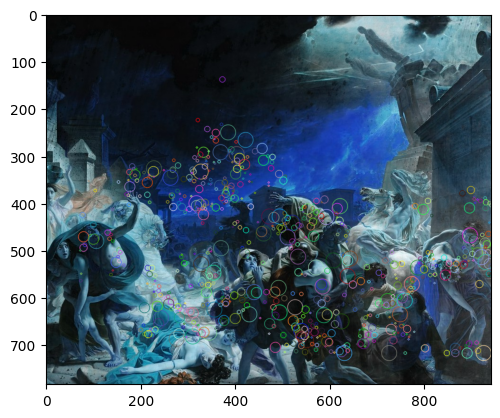

In [84]:
plt.imshow(result1)

Склейка

Execution time:  0.03917360305786133


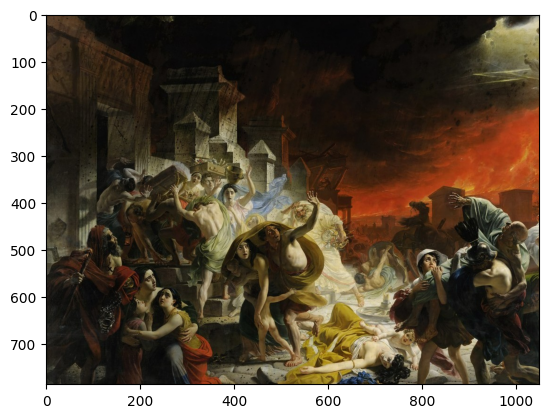

In [121]:
img_ = cv2.imread('part2_brief.jpg')
img1 = cv2.cvtColor(img_,cv2.COLOR_BGR2GRAY)

img = cv2.imread('part1_brief.jpg')
img2 = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

org = cv2.imread('original.jpg')
org = cv2.cvtColor(org, cv2.COLOR_BGR2GRAY)

start_time = time.time()
star = cv2.xfeatures2d.StarDetector_create()
kp = star.detect(org,None)
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()

kp1, des1 = brief.compute(imgs[0], kp)
kp2, des2 = brief.compute(imgs[1], kp)

bf = cv2.BFMatcher_create()
matches = bf.knnMatch(des1, des2,k=2)
good = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good.append(m)

MIN_MATCH_COUNT = 10
if len(good) > MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good]).reshape(-1,1,2)
    M, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    dst = cv2.warpPerspective(img1, M, ((img1.shape[1] + img2.shape[1]), img2.shape[0])) 
end_time = time.time()
print("Execution time: ", end_time - start_time)
dst = dst[:780, :550]
dst = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(dst)

#### Оригинальное изображение

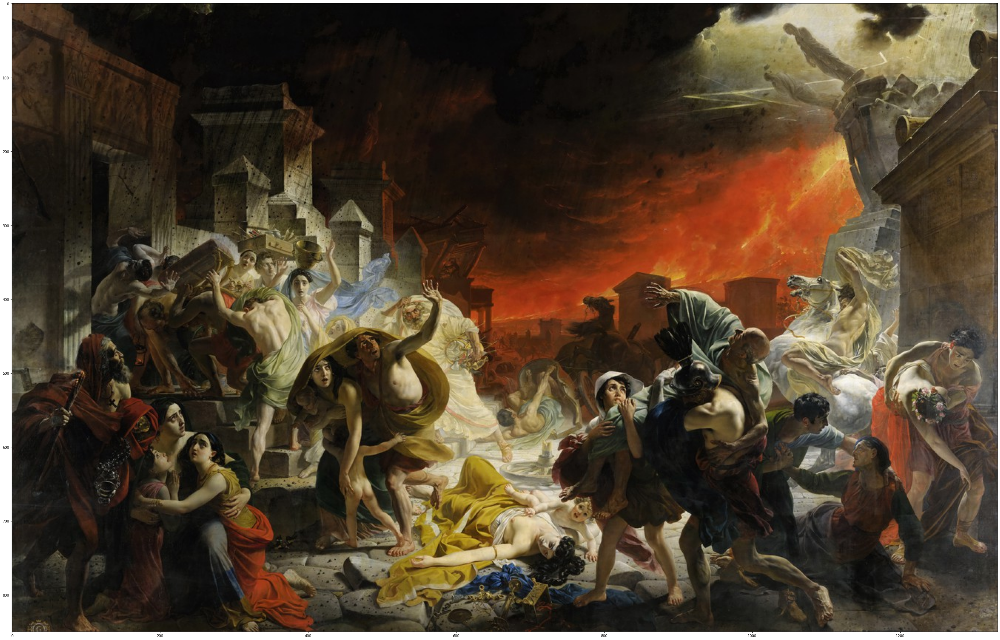

In [86]:
original = cv.imread("original.jpg")
show(original, (50,50))

#### Результаты

- самый быстрый алгоритм: brief, затем orb и sift
- по количеству найденных особых точек: sift, brief, orb